### Read _.fits_ raw data

---

For reading the `.fits` data-set one may use the utils library. It will get a HUD table with 3 items, and only the last one (`index = 2`) has the proper information for experimental analysis.

In [1]:
import utils

folder_list = [ './database/raw_fits/confirmed_targets',
                './database/raw_fits/red_giants',
                './database/raw_fits/bright_stars' ]

dread = utils.data_helper.Reader()
curves  = dread.from_folder(folder=folder_list[0], label='confirmed targets', index=2)
#curves += dread.from_folder(folder=folder_list[1], label='red giants', index=2)
#curves += dread.from_folder(folder=folder_list[2], label='bright stars', index=2)

INFO:reader_log:Reader module created...
INFO:reader_log:Reading 37 curve packages...


For further plotting the data, we will import the Bokeh library and setup the plotting environment

In [2]:
from ipywidgets import interact
from bokeh.palettes import Magma
from bokeh.layouts import column
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource
from bokeh.io import output_notebook, push_notebook

output_notebook()

color_theme = Magma[10]

Loading BokehJS ...

Just as an example of one of the curves readed, let's plot one of the resulted curves

In [3]:
default_plt_size = [600, 400]

p = figure(x_axis_type="datetime", plot_width=default_plt_size[0], plot_height=default_plt_size[1], title="White Light Curve Example")
p.grid.grid_line_alpha = 0
p.yaxis.axis_label = 'White Intensity'
p.xaxis.axis_label = 'Time (mm/yyyy)'
p.xgrid.band_fill_color = color_theme[0]
p.xgrid.band_fill_alpha = 0.05

p.line(curves[0]["DATE"], curves[0]['WHITEFLUXSYS'], legend_label='Raw Light Curve', line_width=3, color=color_theme[2], muted_alpha=0.2, line_cap='round')
p.legend.location = "top_right"
p.legend.click_policy = "mute"

show(p)

### Preprocessing data

---

This is just a simple analysis to manipulate some properties of the data before introducing the machine learning analysis. Actually the main idea is to prepare the time series data in a feasible manner for a simple machine learning analysis afterwards.

First, the data will be treated to ensure a discrete time series as features, by using some resampling techniques, since most of the time series present non-evenlly spaced samples.

After that, it is necessary to create the labels to indicate the regions of eclipse along the time series, like `True = 'eclipse'` and `False = 'not eclipse'`. To achieve this goal, a filtering technique is presented to remove the noise from the data, since the data is highlly contaminated. With the noise free time series, it is possible to compute the discrete derivative of the time-series and check the regions of high variation... those regions characterize the big light variation during the eclipse and can be used to map the periods where there are eclipses. 

#### Time sample analysis

To analyse the time sample of the series, one can do a candle plot for each time-series curve. At each candle plot it is represented the distribution of the diference `t[k] - t[k-1]` for `k` representign each sample of the time-series. 

In [4]:
import plotly.graph_objects as go

import pandas as pd
import numpy as np
from datetime import datetime

dt,dt_max,dt_min,dt_mean = [],[],[],[]
for curve in curves:
    diff_time = np.diff(curve["DATE"])
    dt.append([x.total_seconds() / 60 for x in diff_time])
    dt_mean.append(np.mean(dt[-1]))
    dt_max.append(np.percentile(dt[-1], 75))
    dt_min.append(np.percentile(dt[-1], 25))
dt_min = np.mean(dt_mean) - 1.05 * ( np.mean(dt_mean) - np.mean(dt_min) )
dt_max = np.mean(dt_mean) + 0.01 * ( np.mean(dt_mean) - np.mean(dt_max) )   
fig = go.Figure(data=[go.Box(y = value) for value in dt])

# format the layout
fig.update_layout(
    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    yaxis=dict(zeroline=False, gridcolor='white'),
    paper_bgcolor='rgb(233,233,233)',
    plot_bgcolor='rgb(233,233,233)' )
#fig.update_yaxes(range=[np.mean(dt_min), np.mean(dt_max)])
fig.update_yaxes(range=[dt_min, dt_max]) # <- Comment this line to see the outliers!!
fig.show()

--- 

#### Resample the time series data

Since the time sample time do not vary that much from one light curve to another, **not considering the outliers**... One can create the sample time as the mean of the median and then resample each time series.

> *Notice that the above figure has the `y` axis clipped from `[8.544, 8.532]`. If the reader comment the line described on the above cell, one will see that there are some worrying outliers. **It is because of those outliers that a resampling technique must be applied!***

In [5]:
import statistics as stt

medians = list()
for time_diffs in dt:
    medians.append( stt.median(time_diffs) )
time_sample = round(stt.mean(medians), 2)

print("The time sample is now {} minutes.".format(time_sample))

The time sample is now 8.53 minutes.


Now that we have a feasible approximation of the time sample, it is possible to use this reference to reseample each time series to this single sample rate.

In [6]:
import scipy.signal as scs

data = {'y':[], 't':[], 'ti':[]}
for curve in curves:
    # Get the time information
    init_time = curve['DATE'][0]
    data_vector = curve['WHITEFLUXSYS']
    time_vector = [(t - init_time).total_seconds() / 60 for t in curve['DATE']]
    # Compute the amount of points
    n_points = int(time_vector[-1] // time_sample)
    # Compute the resampled time series
    res_data, res_time = scs.resample(data_vector, n_points, time_vector)
    data['y'].append( res_data )
    data['t'].append( res_time )
    data['ti'].append(init_time)

To check if the new time sample was correctly placed and there is no more samples with outlier time samples. One can use the histogram of the time sample variation of all light curves to ensure the consistency of the sample time.

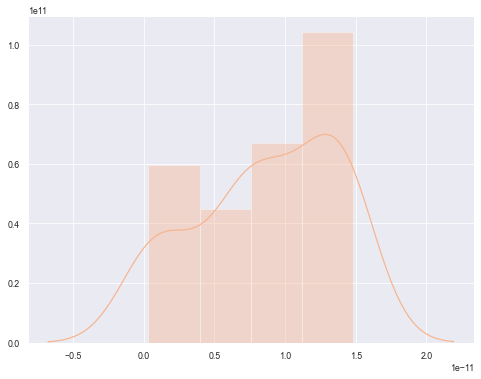

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

plt.figure(figsize=(8,6))
t_std = [stt.stdev(np.diff(t)) for t in data['t']]
sns.distplot(t_std)
plt.show()

---

#### Create eclipse labels

The main idea is to create a binary label for the eclipse pattern from the light curve. For that, we could check the light curve derivative to analyse the time series variation along time. Usually when you have a high variation, the chances of having a eclipse is bigger. As an example, let's plot the derivative of one particular light curve, `index = 2`.

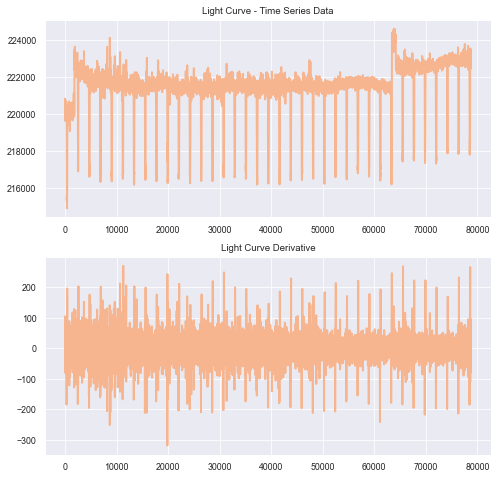

In [21]:

index = 5

sns.set(context="paper",style="darkgrid",palette="rocket_r")
fig, (ax1, ax2) = plt.subplots(2,1,figsize=(8,8))

ax1.set_title('Light Curve - Time Series Data')
ax1.plot(data['t'][index], data['y'][index], lw=2)

ax2.set_title('Light Curve Derivative')
ax2.plot(data['t'][index][1:], np.diff(data['y'][index])/time_sample, lw=2)
plt.show()

But the data is too noisy... We cannot see what we're specting. To reduce the amount of noise on data we might use the PyAstronomy library that has some interesting smoothing algorithms, such as the *hamming* filter. We can also change the window size considered for filtering the light curve, here as an example we are using ` window = 33` samples. 

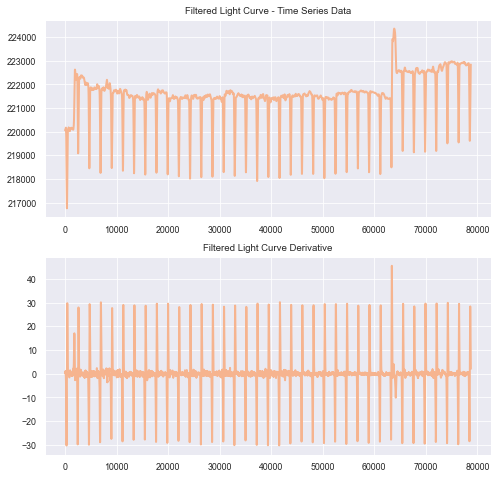

In [22]:
from PyAstronomy import pyasl

window = 33
algorithm = 'hamming'
sm1 = pyasl.smooth(data['y'][index], window, algorithm)

sns.set(context="paper",style="darkgrid",palette="rocket_r")
fig, (ax1,ax2) = plt.subplots(2,1,figsize=(8,8))

ax1.set_title('Filtered Light Curve - Time Series Data')
ax1.plot(data['t'][index], sm1, lw=2)

ax2.set_title('Filtered Light Curve Derivative')
ax2.plot(data['t'][index][1:], np.diff(sm1)/time_sample, lw=2)
plt.show()


Now we are talking!! Without the noise is possible to observe the peaks and their respective variation! From these graphs it is possible to see, that with a simple threshold selection it is possible to infer the regions where we have the eclipses.

---

Then, to introduce some statistics perspective to the result, and make it more automatic, the mean and standard deviation of the light curve variation is used to determine possible decision thresholds. 

In [10]:
variation_mean = np.average(np.diff(sm1)/time_sample)
variation_stan = np.std( np.diff(sm1)/time_sample )

print("The varaition signal has a mean around {}".format(round(variation_mean,3)))
print("And a standard deviation around {}".format(round(variation_stan,2)))

The varaition signal has a mean around 0.035
And a standard deviation around 8.43


Therefore, one can create a threshold close to `+/- std(variation)`, `+/- 2 * std(variation)` and `+/- 3 * std(variation)`, as one can see in the next bellow figure.

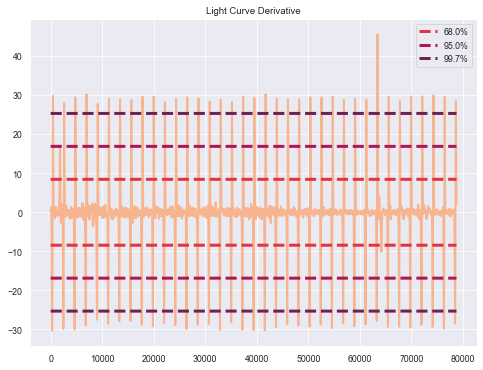

In [23]:
sns.set(context="paper",style="darkgrid",palette="rocket_r")
size = data['t'][index][1:].shape[0]
one_std = variation_stan * np.ones((size,1))

plt.figure(figsize=(8,6))
plt.title("Light Curve Derivative")
plt.plot(data['t'][index][1:], np.diff(sm1) / time_sample, lw=2, c='C0')
plt.plot(data['t'][index][1:],  1*one_std, '--', lw=3, c='C2', label='68.0%')
plt.plot(data['t'][index][1:],  2*one_std, '--', lw=3, c='C3', label='95.0%')
plt.plot(data['t'][index][1:],  3*one_std, '--', lw=3, c='C4', label='99.7%')
plt.plot(data['t'][index][1:], -1*one_std, '--', lw=3, c='C2')
plt.plot(data['t'][index][1:], -2*one_std, '--', lw=3, c='C3')
plt.plot(data['t'][index][1:], -3*one_std, '--', lw=3, c='C4')
plt.legend()
plt.show()

Now one can create a `listener` to check each peak and create the respective eclipse label. First it is necessary to check two states: the first is the state of `in_eclipse` and the second the `out_eclipse`. Which will map when the series goes into one eclipse, then out of the eclipse.

In [12]:
trigger, out_eclipse = False, True # because it starts out of the eclipse
light_variation = np.diff(sm1) / time_sample
light_variation = light_variation.tolist()
threshold = [-3*variation_stan, 3*variation_stan]

light_state = [False]
size = len(light_variation)
for k in range(size):
    if out_eclipse:
        if light_variation[k] < threshold[0]:
            out_eclipse = False
    else:
        if (light_variation[k-1] > threshold[1]) \
            and (light_variation[k] < threshold[1]):
            out_eclipse = True
    light_state.append(out_eclipse)

With those results, lets see if we can plot the light curve and highlight the moments where we have a suposed eclipse.

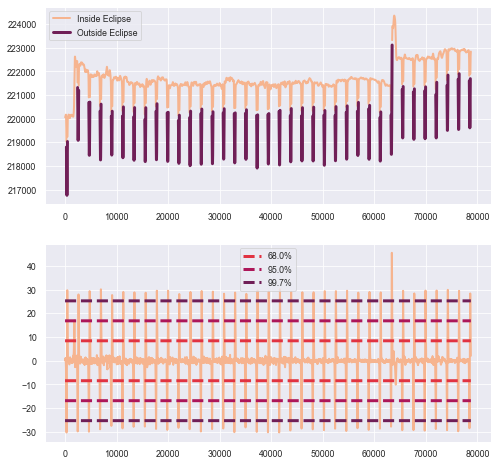

In [24]:

in_eclipse = np.ma.masked_where(~np.array(light_state), sm1)
out_eclipse = np.ma.masked_where(np.array(light_state), sm1)

fig, (ax1, ax2) = plt.subplots(2,1,figsize=(8,8))

ax1.plot(data['t'][index], in_eclipse, label='Inside Eclipse', lw=2, c='C0')
ax1.plot(data['t'][index], out_eclipse, label='Outside Eclipse', lw=3, c='C4')
ax1.legend()

ax2.plot(data['t'][index][1:], np.diff(sm1) / time_sample, lw=2, c='C0')
ax2.plot(data['t'][index][1:],  1*one_std, '--', lw=3, c='C2', label='68.0%')
ax2.plot(data['t'][index][1:],  2*one_std, '--', lw=3, c='C3', label='95.0%')
ax2.plot(data['t'][index][1:],  3*one_std, '--', lw=3, c='C4', label='99.7%')
ax2.plot(data['t'][index][1:], -1*one_std, '--', lw=3, c='C2')
ax2.plot(data['t'][index][1:], -2*one_std, '--', lw=3, c='C3')
ax2.plot(data['t'][index][1:], -3*one_std, '--', lw=3, c='C4')

plt.legend()
plt.show()

Checkpoint!! One thing that we also need to do, is change the `index` variable and check each exoplanet curve and see if we could ensure that this algorithm works for most of then. And also with the bright stars and red giants...

After that we are ready to engage on more complex analysis, such as statistical approaches and machine learning techniques!

> **Notice one interesting thing: using the derivative approach, the steady state information of the light curve is automatically discarded! This is a hell of deal, since it is already a filter that mitigates the influence of low frequency siganls and highlight the effect of high frequency ones!!!! O.o Crazy!! Since we only want to analyse the bahavior of the high descent variation, when there are eclipses, the signal derivation is the approach that most highlight this feature. :)**

### Generation algorithms

---

Here, the algorithm presented above is implemented for each time serie curve and then we generate a file with the pre-processed data. So for that we need to run the following the next procedure. Since all time series are already resampled, only the procedure of filtering and labelling are necessary to be made for all time series. This is the function, that provided the resampled time series, it returns a the filtered and labeled data:

In [14]:
def filter_series(data=None, window=33, algorithm="hamming"):
    '''
        This is the function used to filter 
    '''
    filtered_curves = {'r':[],'y':[],'t':[],'i':[]}
    for curve, time, init in zip(data['y'], data['t'], data['ti']):
        filt_curve = pyasl.smooth(curve, window, algorithm)
        filtered_curves['r'].append( curve )
        filtered_curves['y'].append( filt_curve )
        filtered_curves['t'].append( time )
        filtered_curves['i'].append( init )
    
    return filtered_curves

In [15]:

filtered_data = filter_series(data=data)


Now that we have the filtered data, we could use the derivative algorithm to label each time series...

In [16]:
def label_series(data=None, time_sample=None, std_num=3):
    '''
    '''
    data['labels'] = []
    for curve in data['y']:
        derivative = np.diff( curve ) / time_sample
        mean, stan = np.mean( derivative ), np.std( derivative )
        derivative, threshold = derivative - mean, std_num * stan 
        light_state, out_eclipse = [False], True
        for k in range(len(derivative)):
            if out_eclipse:
                if derivative[k] < - threshold:
                    out_eclipse = False
            else:
                if (derivative[k-1] > threshold) \
                    and (derivative[k] < threshold):
                    out_eclipse = True
            light_state.append( out_eclipse )
        data['labels'].append( light_state )
    return data

In [17]:

filtered_data = label_series(data=filtered_data, time_sample=time_sample)


### Save the pre-processed data

---

#### Save as _.mat_ file

This is just a function that will save the filtered data as a MATLAB data file:

In [18]:
import scipy.io as sio

file_path = './filtered.mat'
sio.savemat(file_name=file_path, mdict=filtered_data)


#### Save as _.pickle_ file

This is a fucntion to save the data as a _pickle_ file to save the dictionary:

In [19]:
import pickle

file_path = './filtered.pkl'

output = open(file_path, 'wb')
pickle.dump(filtered_data, output)
output.close()
